In [1]:
# %matplotlib widget
# ==== 1) load packages ====
import numpy as np
import pandas as pd
import math
import glob
from sklearn.metrics import ndcg_score
from sklearn.preprocessing import StandardScaler
import torch
import os
os.chdir(
    # "/home/yliu420/Project/Belief-Elicitation-on-LLM-postrelease/analysis"
    "/Users/jingyi/Research/FYP/LLM/conjoint_openai/Belif-Elicitation-on-LLM-postrelease/analysis"
)
from analysis_pkg.preprocess import *
from analysis_pkg.models import *
from analysis_pkg.visualization_PCA import *
from llm_belief.analysis import visualize_probability_distribution
torch.manual_seed(2025)

In [2]:
scored_df = pd.read_csv('../data/scored_profiles_shuffled.csv')
real_df = pd.read_csv('../data/scored_real_profiles.csv')
score_models = [
    'MLP_score',
    'MLP_attention_score',
    'Logistic_regression_score',
    'adplasso_interaction_thres0.0001',
    'adplasso_interaction_square_thres0.0001',
    'adplasso_square_thres0.0001',
    'adplasso_interaction_square_thres0.001',
    'XGBoost',
    'LogitSquare'
]
feature_names = scored_df.columns[:10].tolist()

# Take 20,000 profiles to draw a smooth plot

In [3]:
df_train = scored_df.iloc[:20000,:]
X_train = preprocess_test(df_train.iloc[:,:10])
X_test = preprocess_test(real_df.iloc[:,:10])
df_full = pd.concat([df_train, real_df], axis=0).reset_index(drop=True)

Saved: ../data/PCA_loading/pca_20k.csv

Top features for PC1 (by |loading|):
                                  feature       PC1       PC2
                Geekbench multicore score  0.666036 -0.030303
          front camera resolution (in MP) -0.536031  0.024839
  rear camera longest focal length (in x) -0.390235 -0.077978
                                      RAM -0.259919 -0.530116
 rear camera main lens resolution (in MP) -0.201255  0.590055
                  screen size (in inches) -0.159893 -0.056265
                        thickness (in mm)  0.057326 -0.361244
                                    price -0.022982  0.148402
                         ultrawide camera -0.003309  0.011253
battery life (in hours of video playback) -0.001696  0.476322

Top features for PC2 (by |loading|):
                                  feature       PC1       PC2
 rear camera main lens resolution (in MP) -0.201255  0.590055
                                      RAM -0.259919 -0.530116
battery life (in 

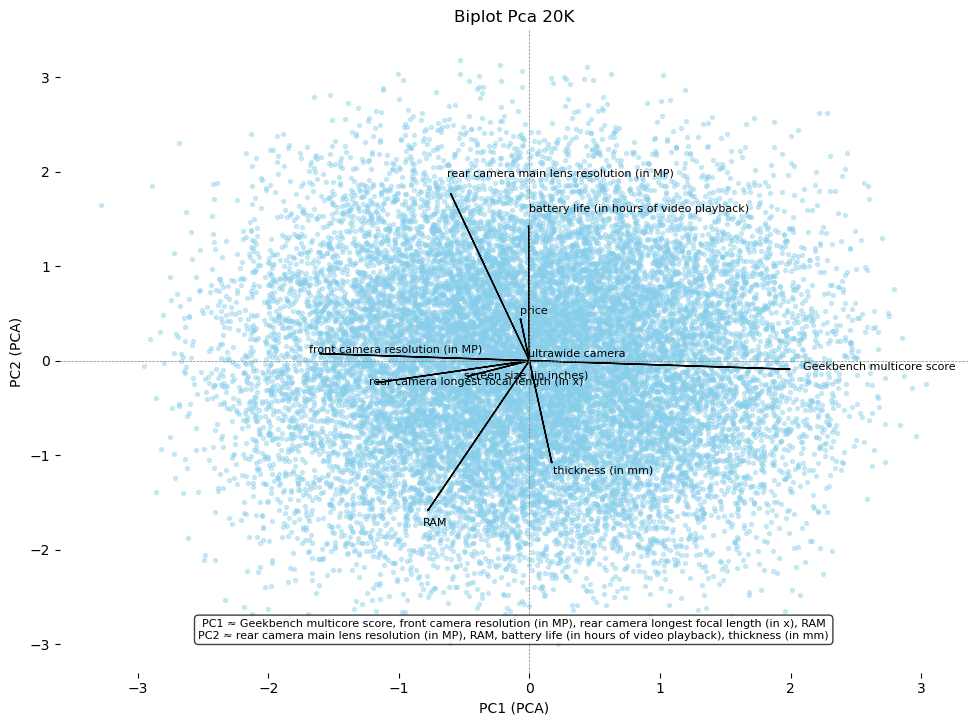

In [4]:
pca_res = pca_reduce(
    X_train=X_train,
    X_test=X_test,
    n_components=2,
    feature_names=feature_names,
    save_loadings_csv_path="../data/PCA_loading/pca_20k.csv",
    random_state=0
)
visualize_feature_contributions_pca(
    X_train=X_train,
    feature_names=feature_names,
    save_path="../plot/biplot_pca_20k.png",
    pca_result=pca_res
)

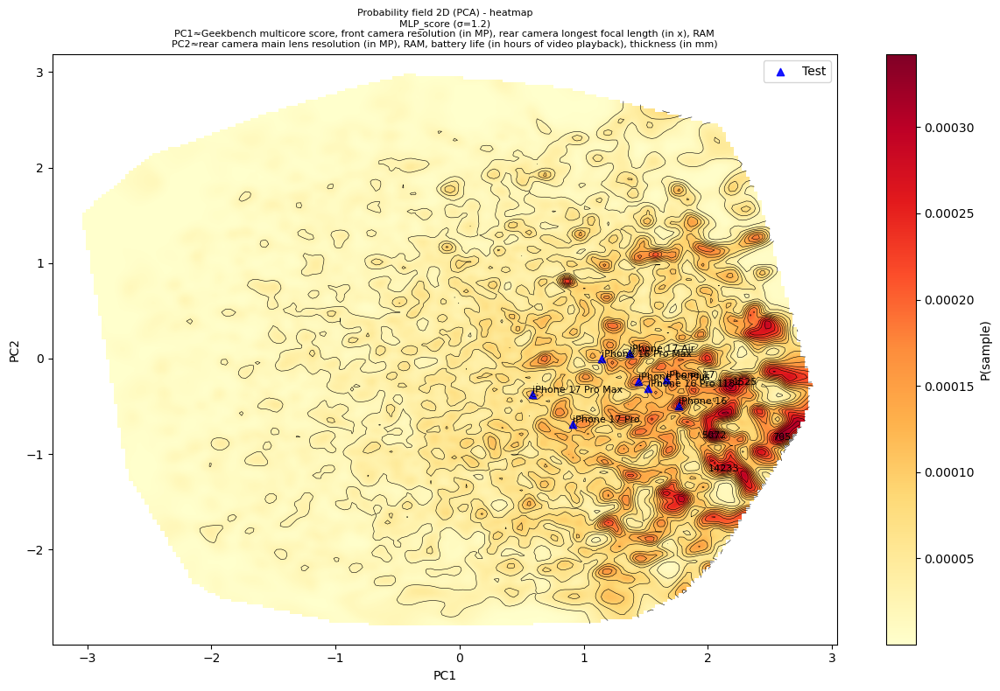

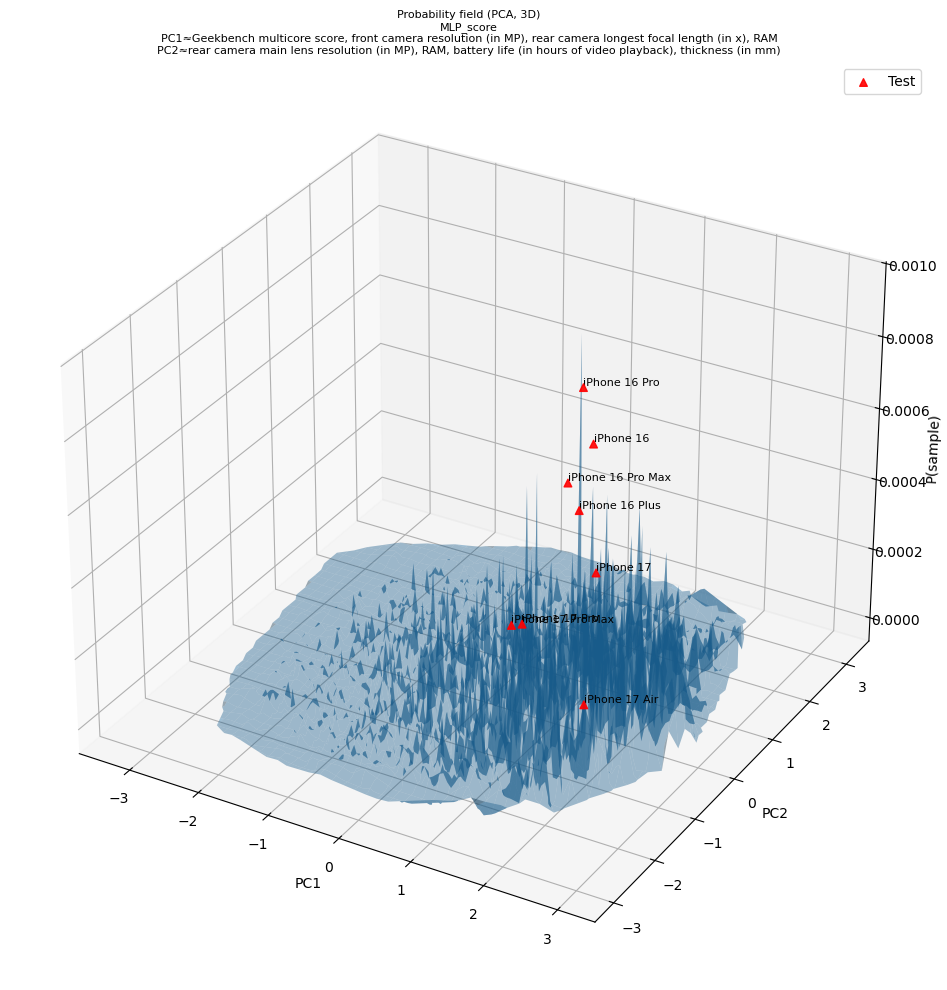

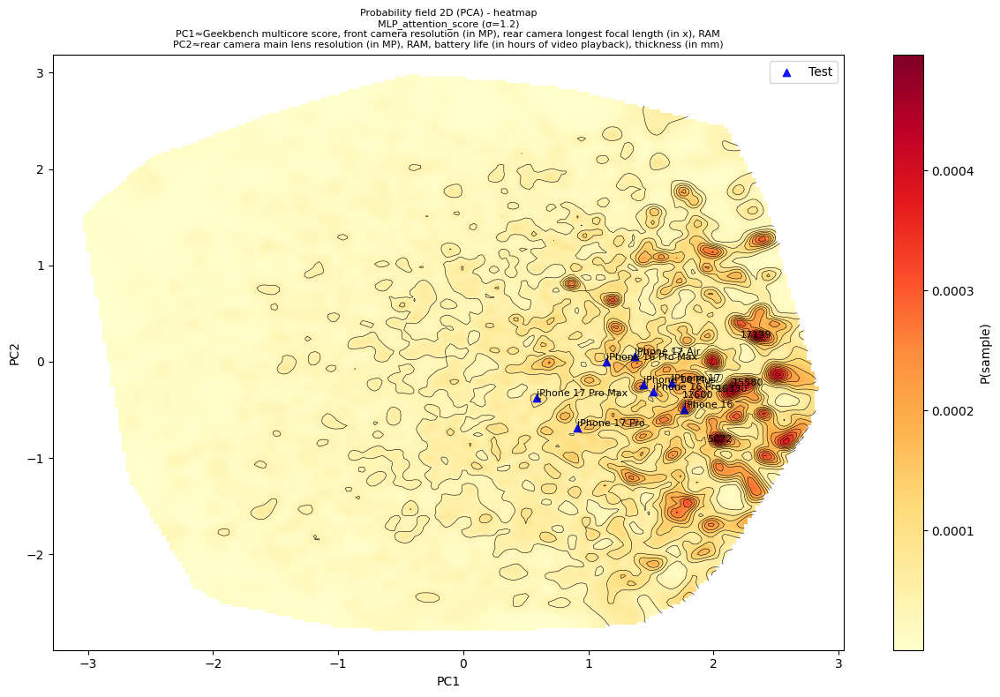

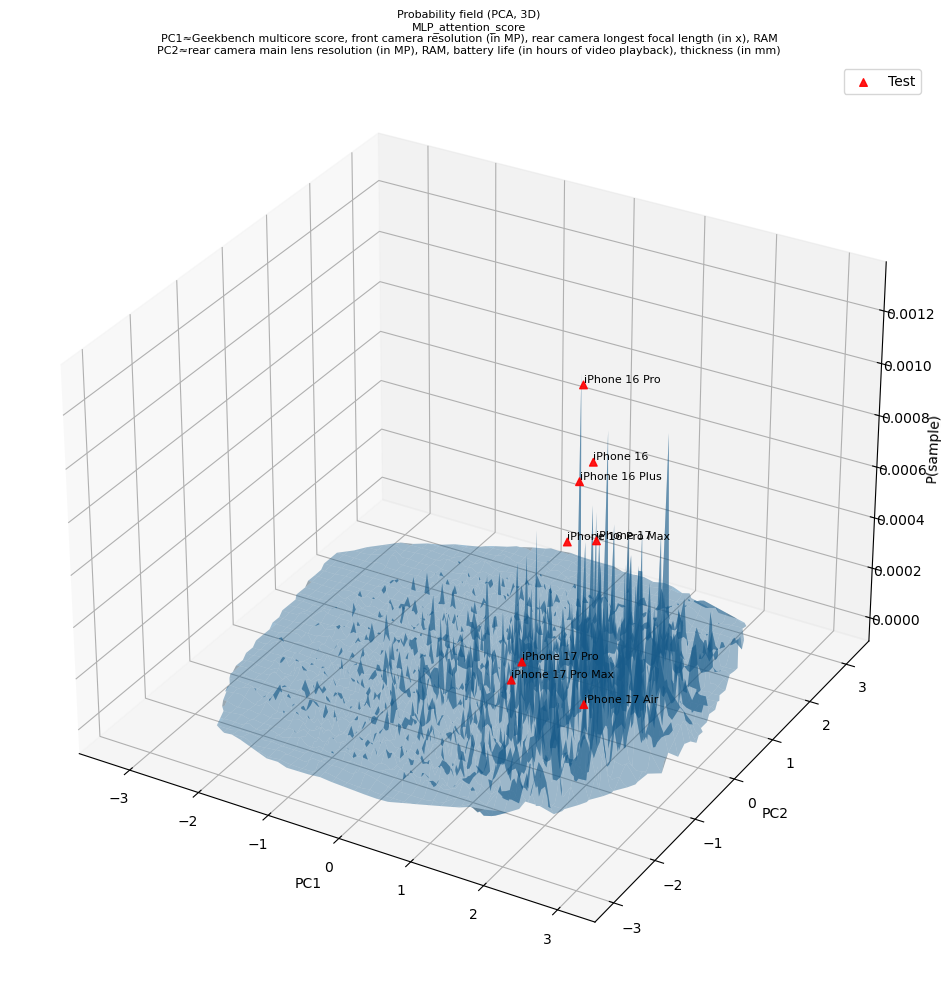

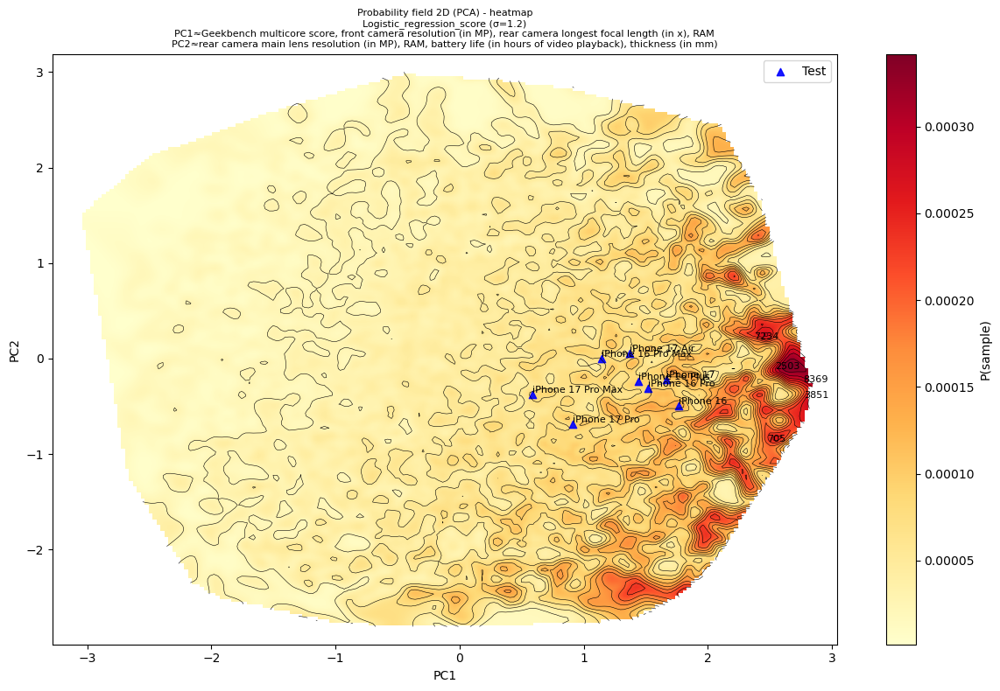

...

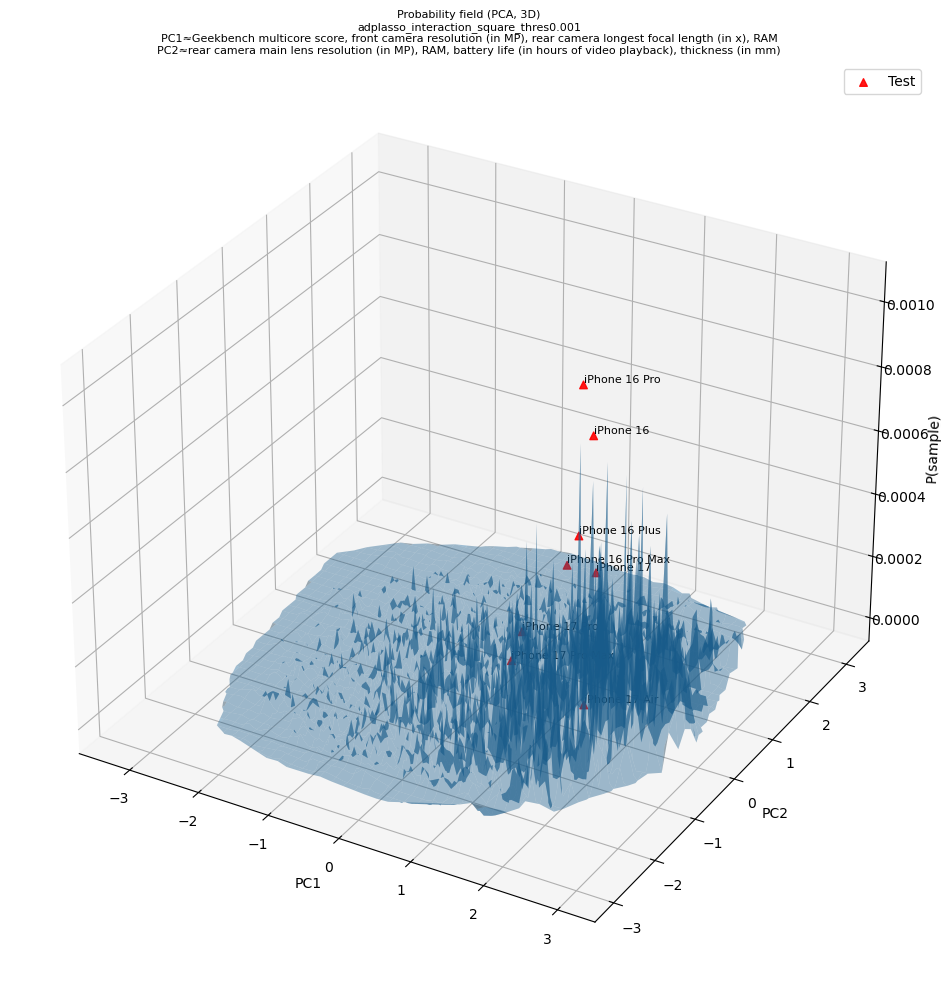

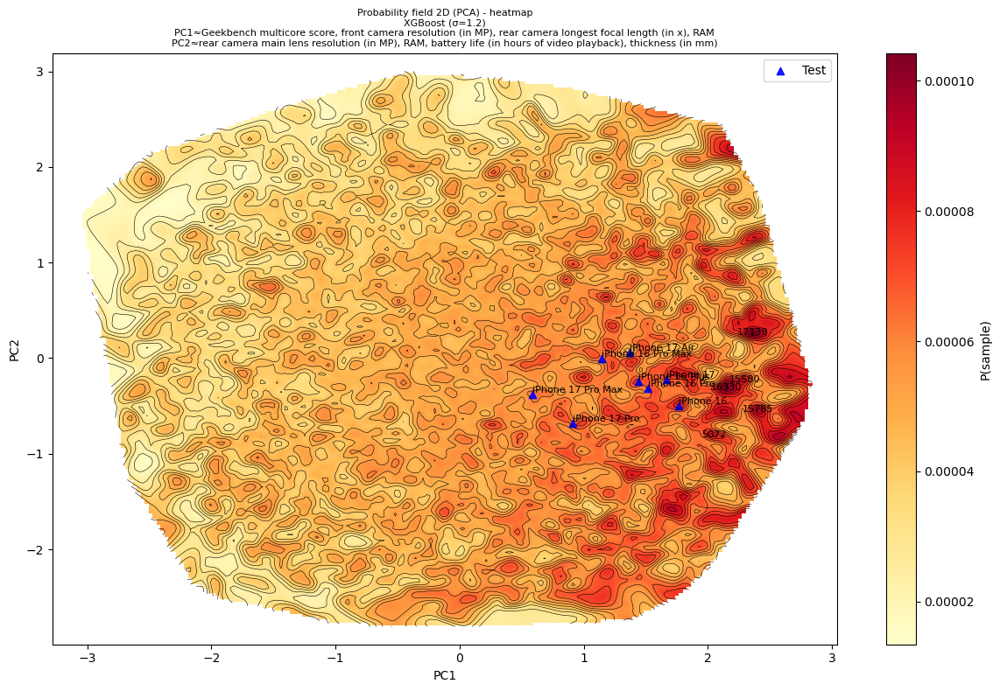

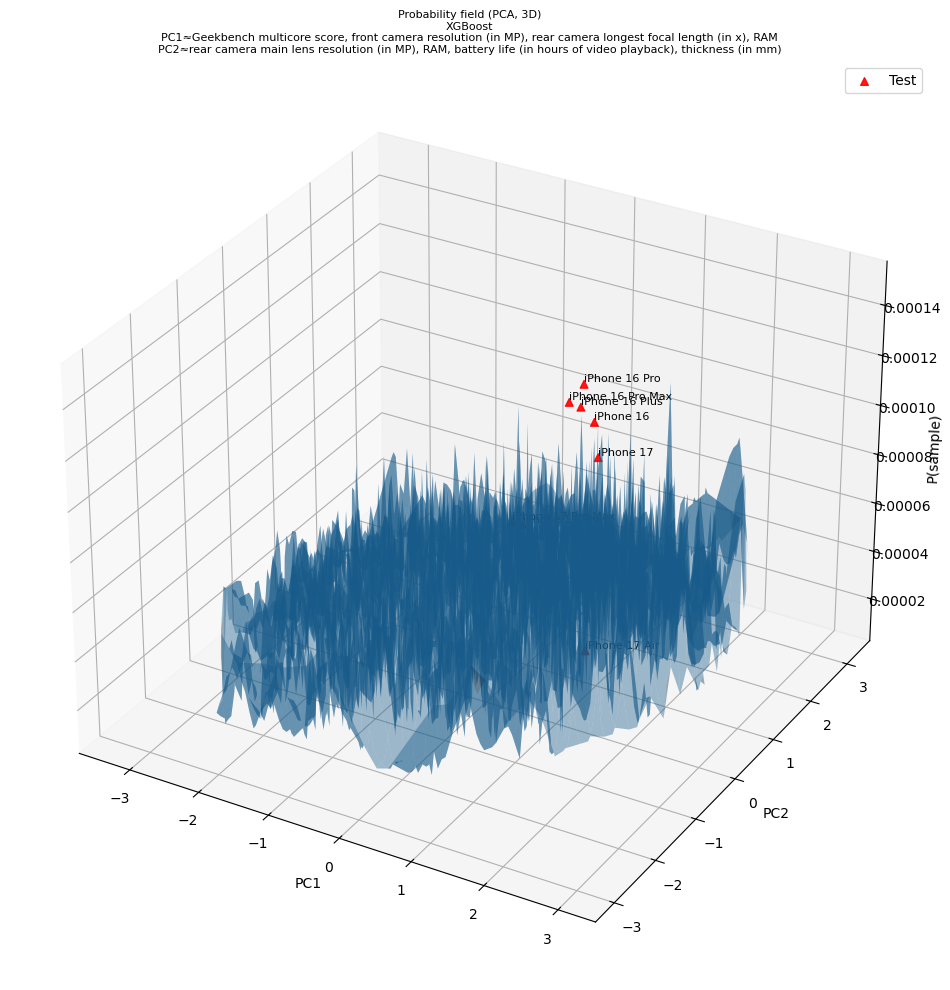

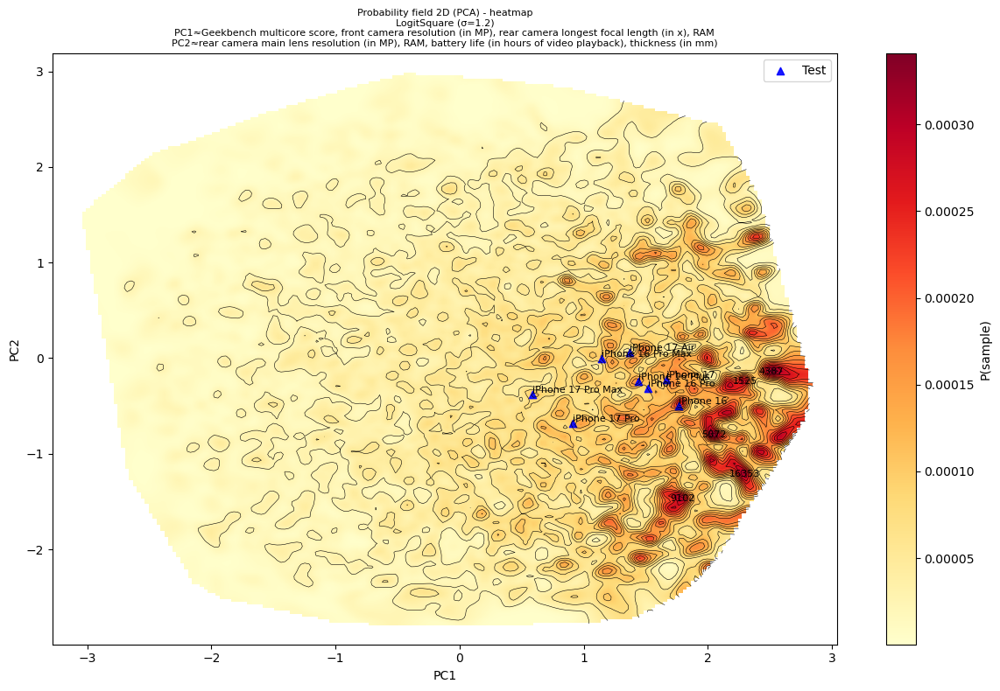

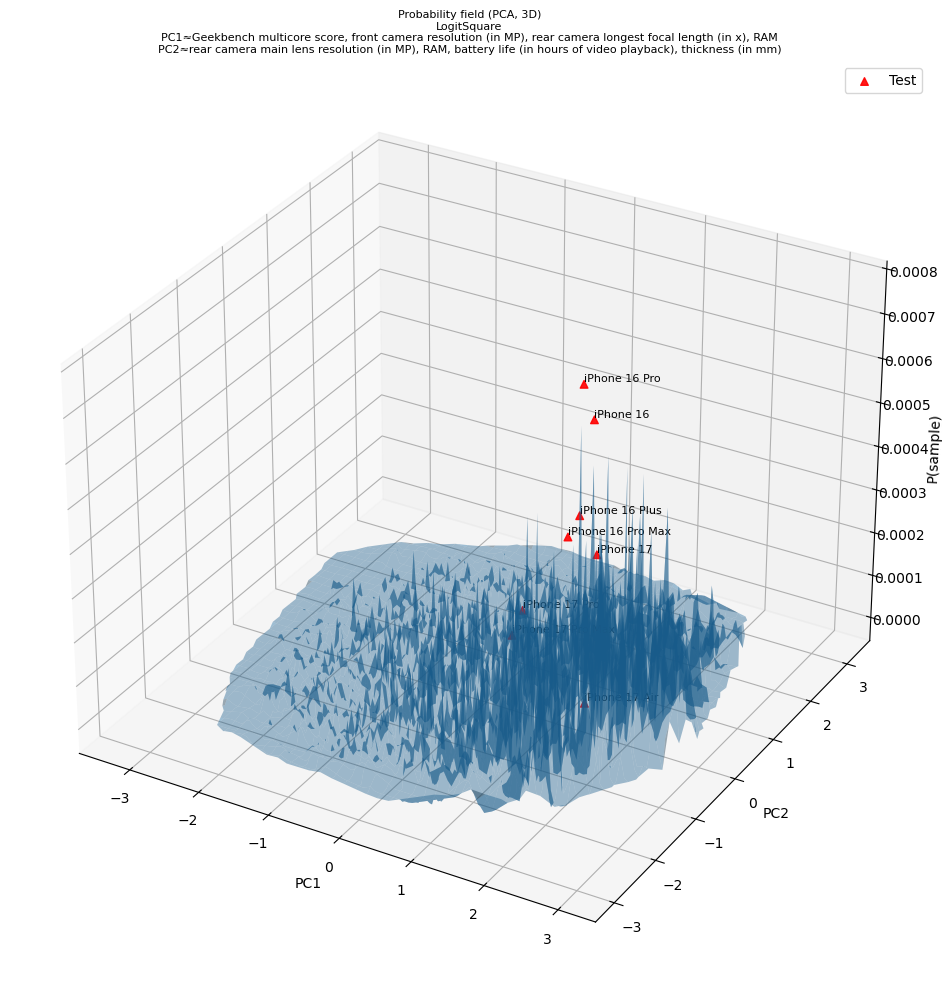

In [5]:
for model_name in score_models:
    scores_train = df_train[model_name].values
    scored_test = real_df[model_name].values
    scores = np.concatenate([scores_train, scored_test], axis=0)
    represent_idx = visualize_probability_distribution(
        X_full=torch.cat([X_train, X_test], dim=0),
        scores=scores,
        num_test=8,
        plot_kind="heatmap",
        smooth_sigma=1.2,
        fig_name=f"PCA_heatmap_{model_name}_20k.png",
        pca_result=pca_res,
        score_model=model_name,
        represent_method="peaks",
        test_idx=real_df['profile_id'].values.tolist(),
    )
    represent_idx = represent_idx.representative_indices
    df_full.iloc[represent_idx,:].to_csv(f"../data/analysis_representative_PCA/PCA_heatmap_{model_name}_20k.csv", index=True)
    _ = visualize_probability_distribution(
        X_full=torch.cat([X_train, X_test], dim=0),
        scores=scores,
        num_test=8,
        plot_kind="3d",
        fig_name=f"PCA_3d_{model_name}_20k.png",
        pca_result=pca_res,
        score_model=model_name,
        test_idx=real_df['profile_id'].values.tolist(),
    )

# Take top 1000 profiles within 20,000 to draw a concentrate plot

/var/folders/kd/bfykm6ds1jg2trz545lw7lnw0000gn/T/ipykernel_16055/4292791709.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_train.sort_values(by=[model_name], ascending=False, inplace=True)


Saved: ../data/PCA_loading/pca_MLP_score_top1000.csv

Top features for PC1 (by |loading|):
                                  feature       PC1       PC2
battery life (in hours of video playback)  0.912691  0.391945
                Geekbench multicore score -0.375369  0.817861
                                    price  0.281324 -0.155008
          front camera resolution (in MP)  0.097948  0.173681
                                      RAM  0.077336  0.009818
                  screen size (in inches) -0.057224  0.371068
  rear camera longest focal length (in x) -0.039985  0.126096
                        thickness (in mm)  0.022217  0.067551
 rear camera main lens resolution (in MP)  0.015773 -0.007182
                         ultrawide camera -0.000658  0.000642

Top features for PC2 (by |loading|):
                                  feature       PC1       PC2
                Geekbench multicore score -0.375369  0.817861
battery life (in hours of video playback)  0.912691  0.391945
   

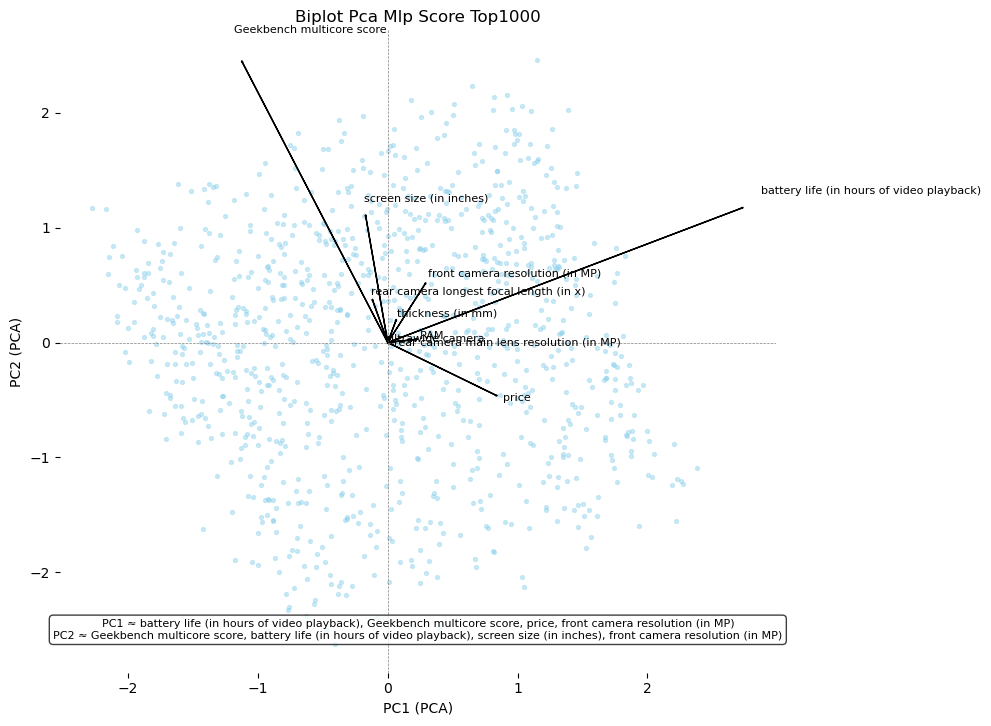

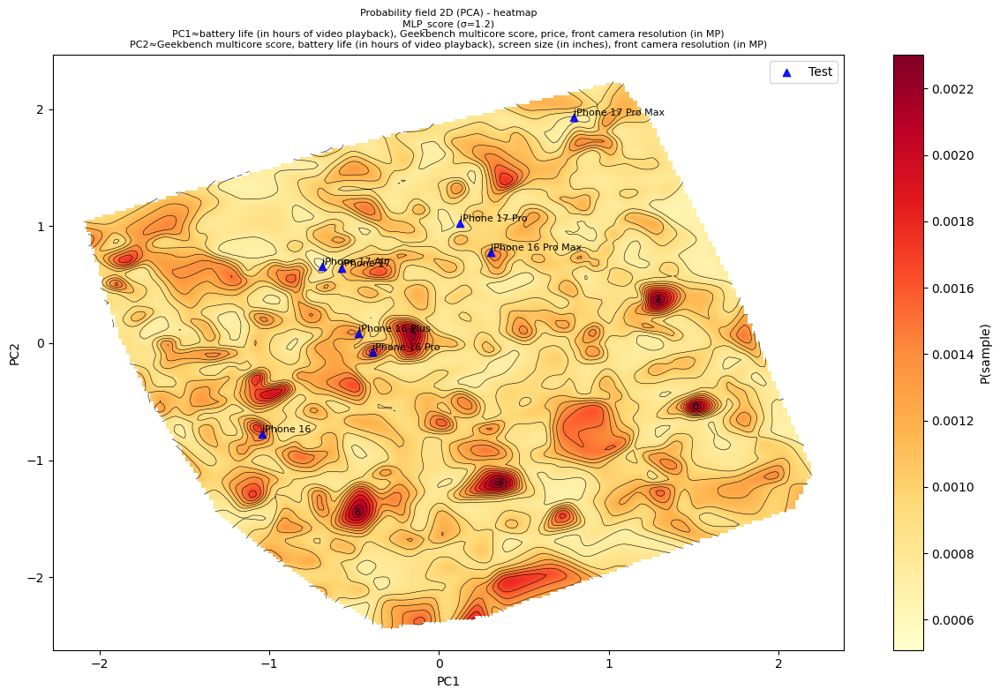

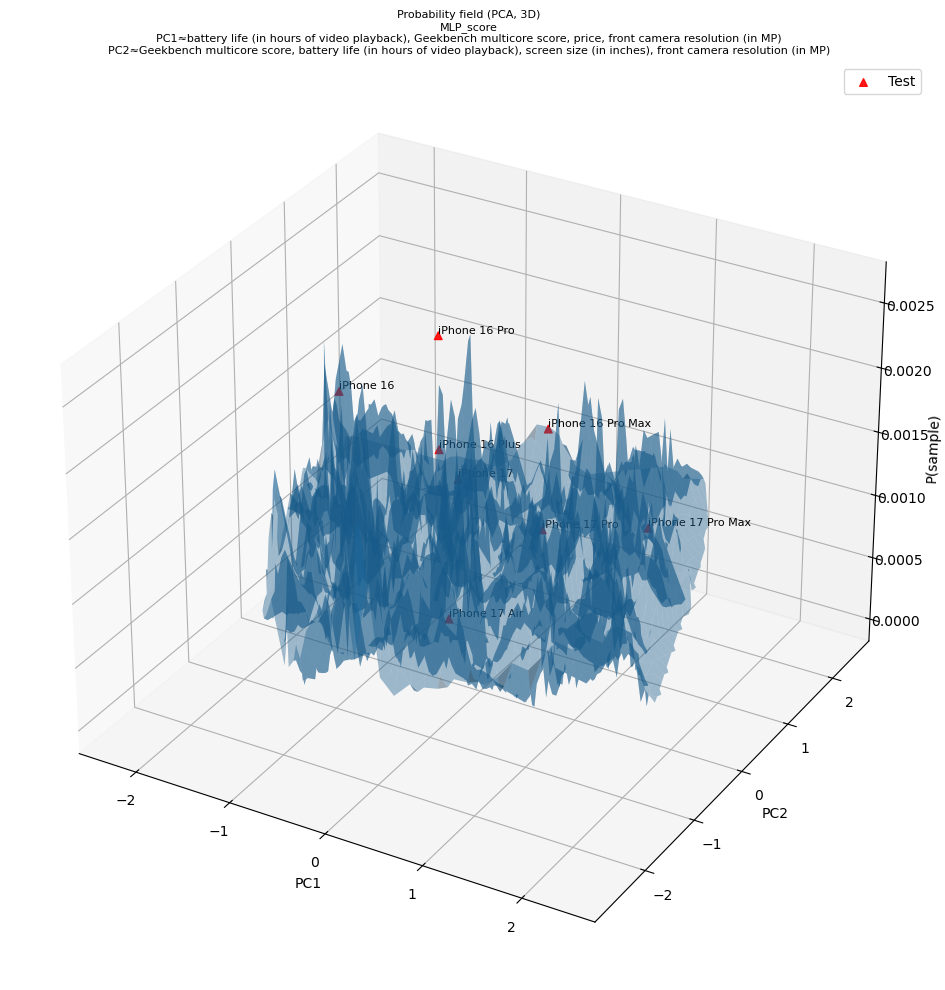

/var/folders/kd/bfykm6ds1jg2trz545lw7lnw0000gn/T/ipykernel_16055/4292791709.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_train.sort_values(by=[model_name], ascending=False, inplace=True)


Saved: ../data/PCA_loading/pca_MLP_attention_score_top1000.csv

Top features for PC1 (by |loading|):
                                  feature       PC1       PC2
battery life (in hours of video playback)  0.936271  0.289222
                                    price  0.268643 -0.576549
          front camera resolution (in MP)  0.163190 -0.109734
                  screen size (in inches) -0.145116  0.178402
                        thickness (in mm)  0.108972  0.016481
                Geekbench multicore score -0.106630  0.697615
 rear camera main lens resolution (in MP)  0.034839  0.016057
                                      RAM -0.017005  0.002814
  rear camera longest focal length (in x) -0.007440  0.003780
                         ultrawide camera -0.000766  0.000653

Top features for PC2 (by |loading|):
                                  feature       PC1       PC2
                Geekbench multicore score -0.106630  0.697615
                                    price  0.268643 -0.

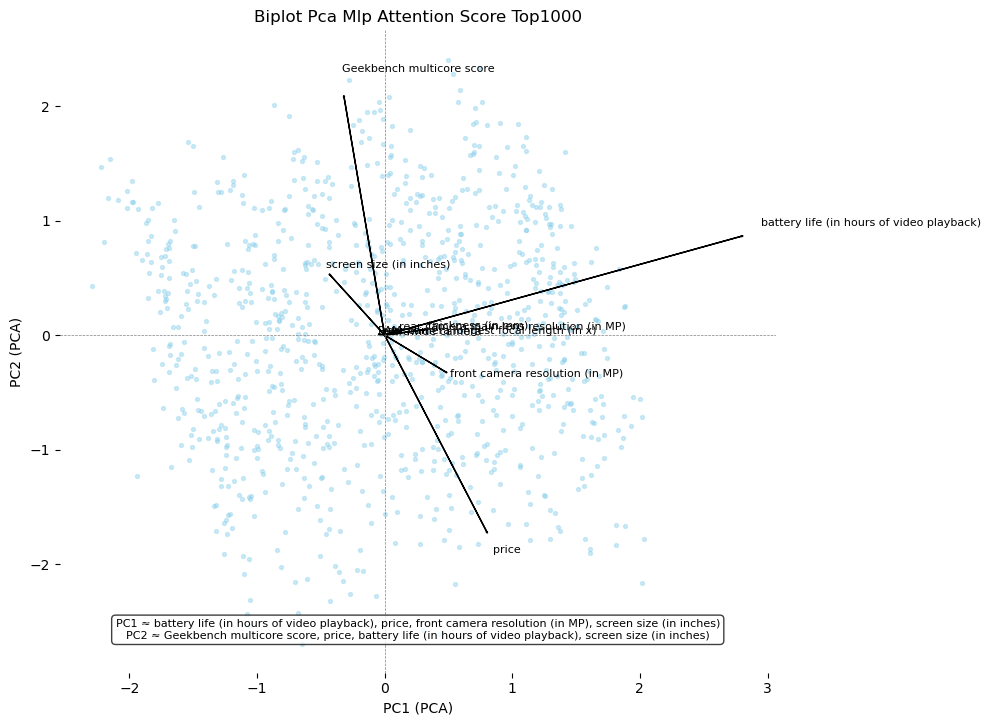

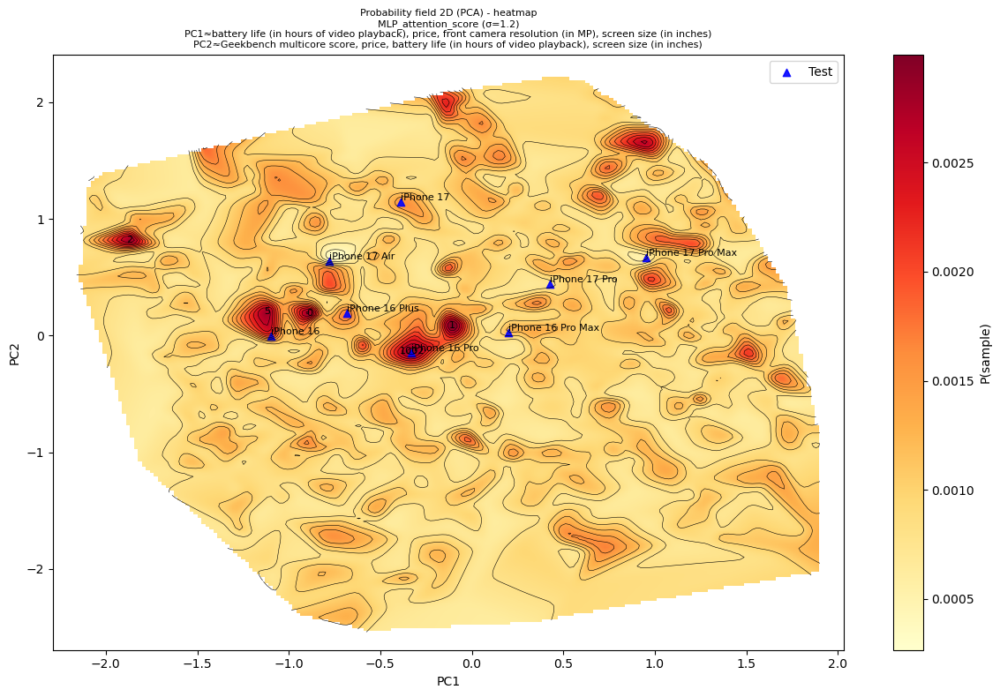

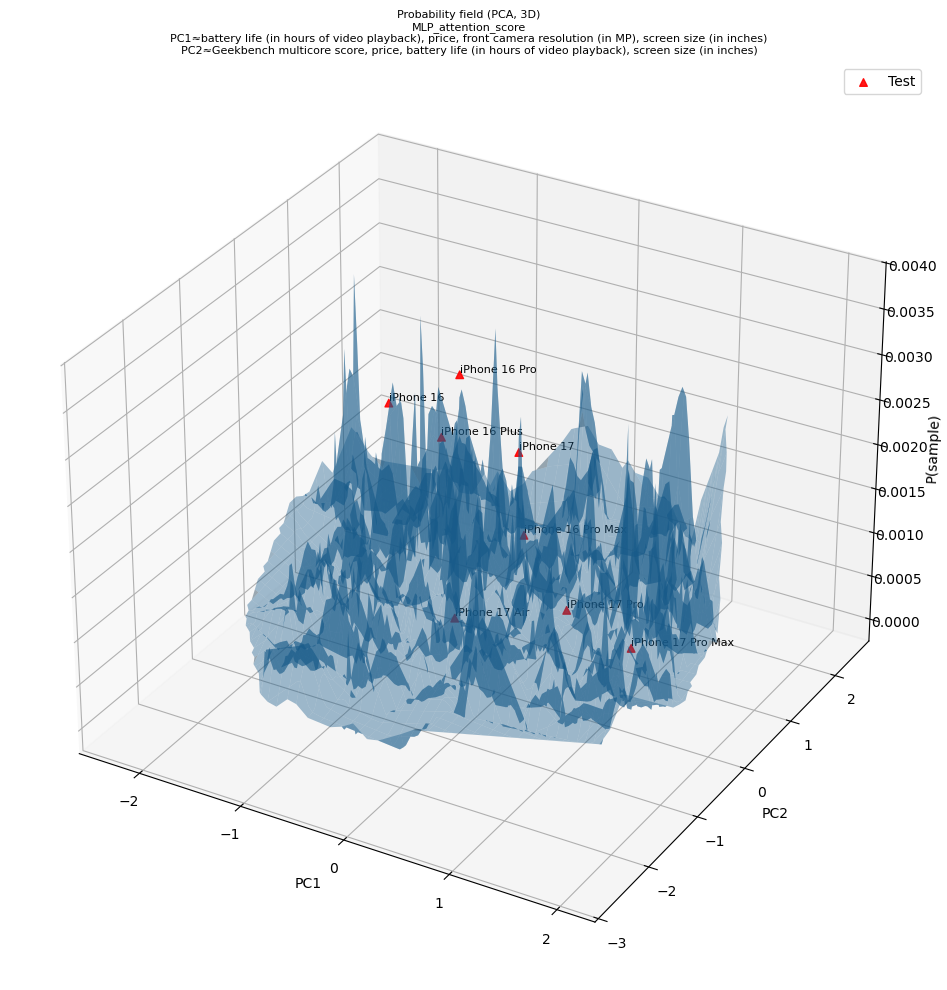

/var/folders/kd/bfykm6ds1jg2trz545lw7lnw0000gn/T/ipykernel_16055/4292791709.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_train.sort_values(by=[model_name], ascending=False, inplace=True)


Saved: ../data/PCA_loading/pca_Logistic_regression_score_top1000.csv

Top features for PC1 (by |loading|):
                                  feature       PC1       PC2
battery life (in hours of video playback)  0.801630 -0.196220
                                    price  0.588781 -0.054014
                                      RAM  0.178870  0.925659
                Geekbench multicore score -0.162084 -0.049753
  rear camera longest focal length (in x) -0.117346 -0.099695
                  screen size (in inches) -0.029004 -0.199102
          front camera resolution (in MP)  0.023003 -0.105536
                        thickness (in mm)  0.013539  0.043485
 rear camera main lens resolution (in MP)  0.002328 -0.074164
                         ultrawide camera -0.000382  0.000530

Top features for PC2 (by |loading|):
                                  feature       PC1       PC2
                                      RAM  0.178870  0.925659
                  screen size (in inches) -0.0290

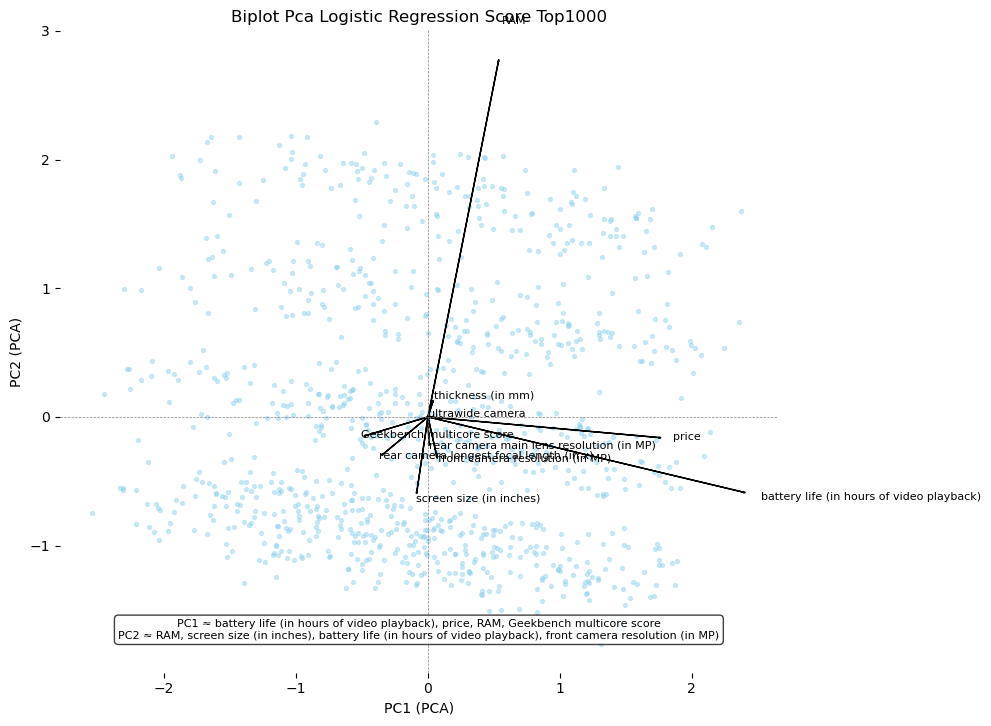

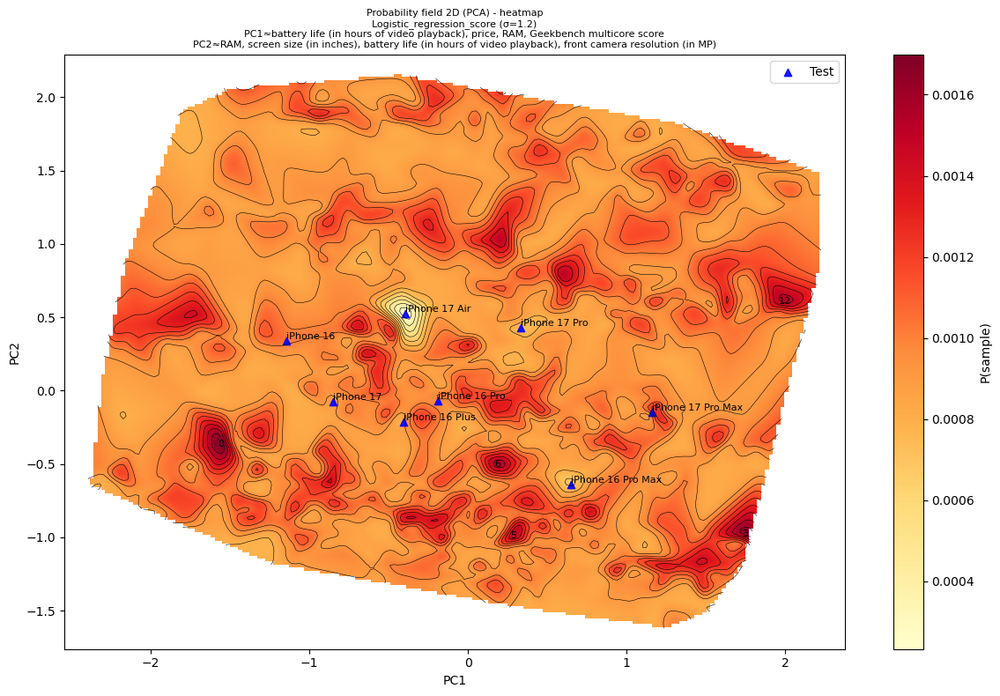

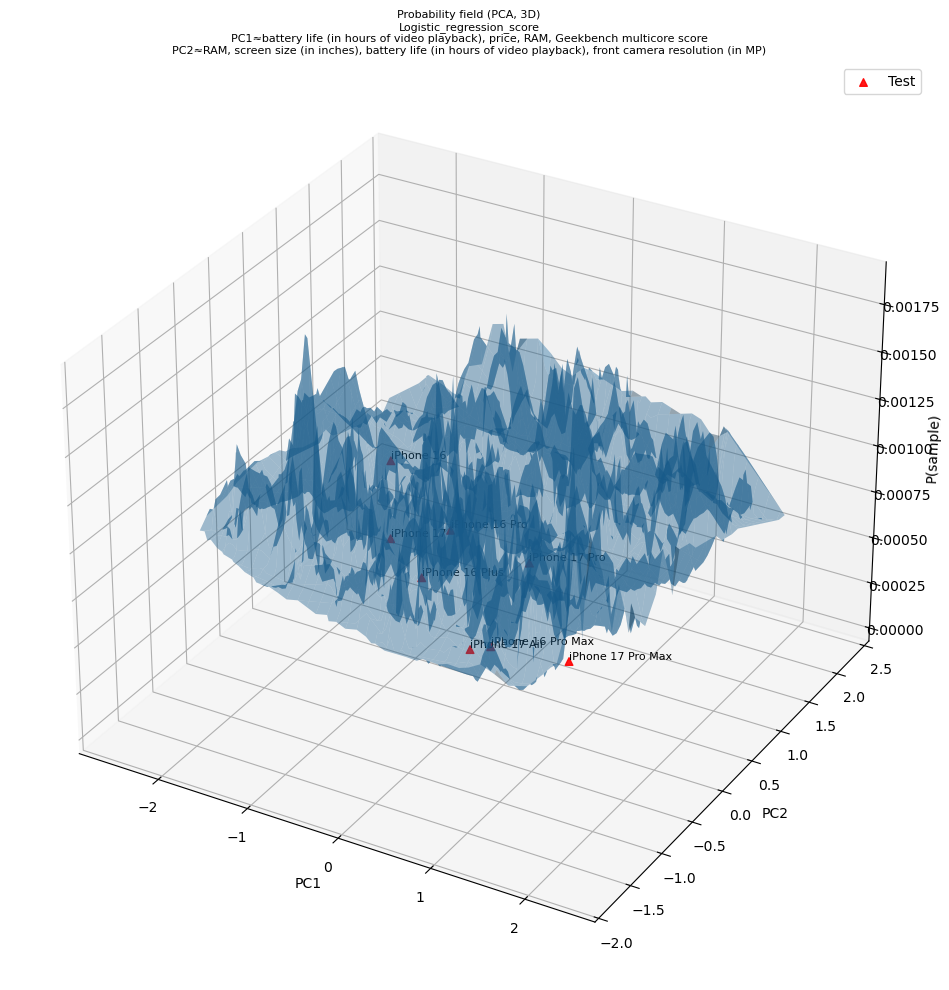

/var/folders/kd/bfykm6ds1jg2trz545lw7lnw0000gn/T/ipykernel_16055/4292791709.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_train.sort_values(by=[model_name], ascending=False, inplace=True)


Saved: ../data/PCA_loading/pca_adplasso_interaction_thres0.0001_top1000.csv

Top features for PC1 (by |loading|):
                                  feature       PC1       PC2
battery life (in hours of video playback)  0.827559 -0.571187
                                    price  0.599786  0.772762
  rear camera longest focal length (in x) -0.136642  0.049321
                Geekbench multicore score -0.097541 -0.096982
          front camera resolution (in MP)  0.074612  0.056481
                  screen size (in inches) -0.036169 -0.053498
 rear camera main lens resolution (in MP) -0.031350  0.041106
                        thickness (in mm) -0.014066 -0.033439
                                      RAM -0.008480 -0.135385
                         ultrawide camera -0.000297  0.000023

Top features for PC2 (by |loading|):
                                  feature       PC1       PC2
                                    price  0.599786  0.772762
battery life (in hours of video playback) 

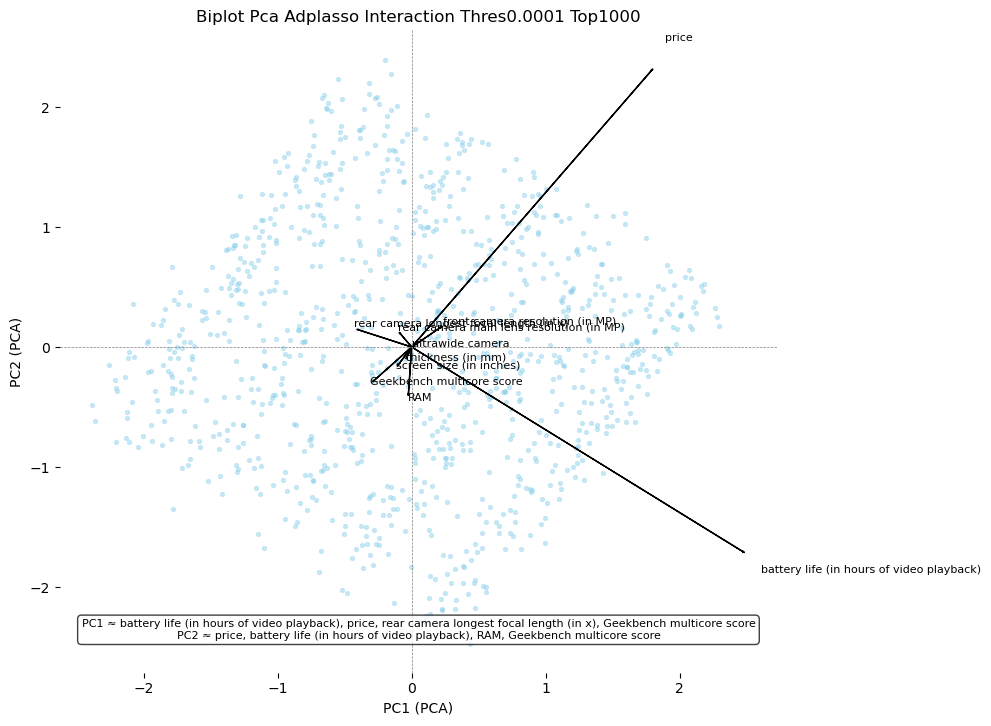

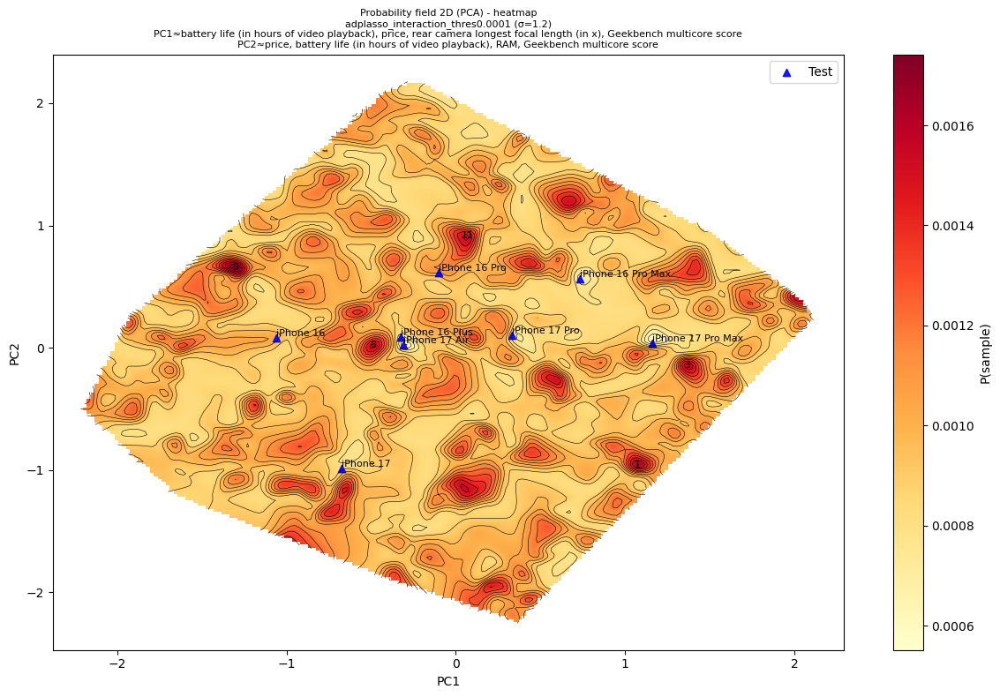

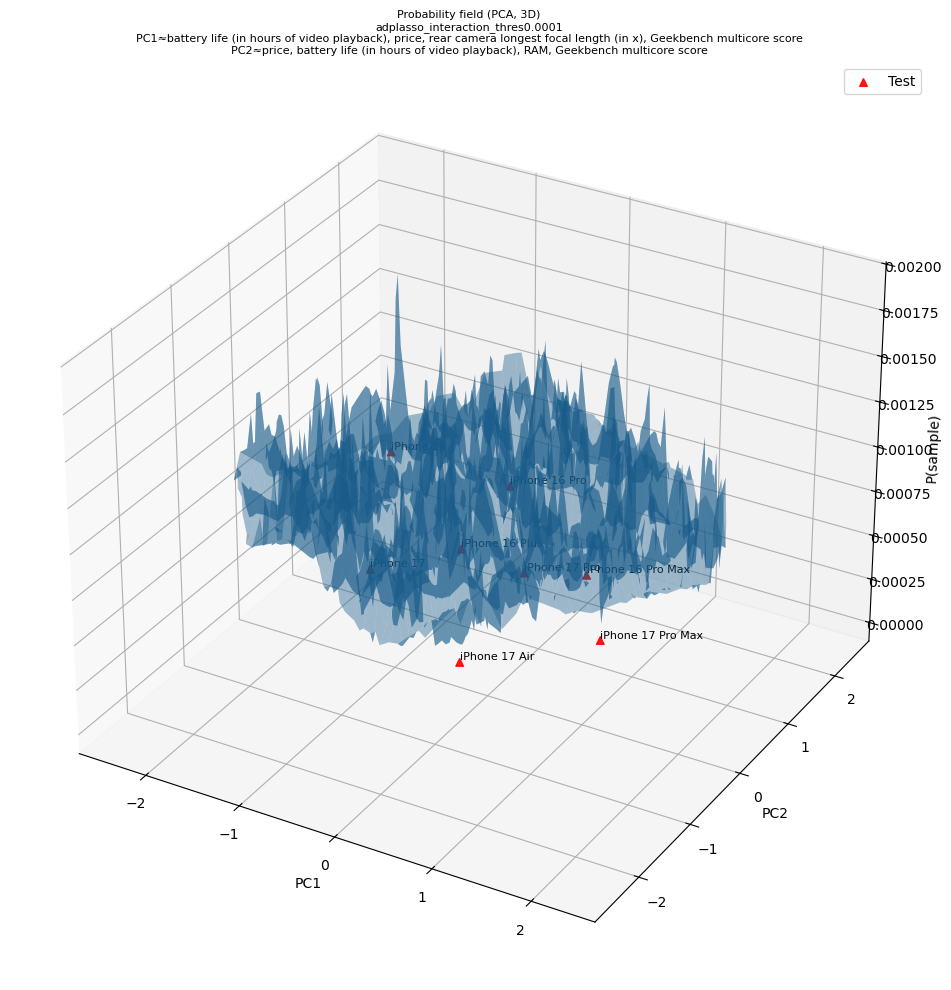

/var/folders/kd/bfykm6ds1jg2trz545lw7lnw0000gn/T/ipykernel_16055/4292791709.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_train.sort_values(by=[model_name], ascending=False, inplace=True)


Saved: ../data/PCA_loading/pca_adplasso_interaction_square_thres0.0001_top1000.csv

Top features for PC1 (by |loading|):
                                  feature       PC1       PC2
battery life (in hours of video playback)  0.700111  0.667225
                Geekbench multicore score -0.653501  0.672158
                                    price  0.329220  0.026854
                  screen size (in inches) -0.196255  0.184151
                                      RAM  0.043223 -0.001482
 rear camera main lens resolution (in MP) -0.032760  0.047603
                        thickness (in mm)  0.028486  0.046711
  rear camera longest focal length (in x)  0.010319 -0.036301
                         ultrawide camera -0.000961  0.000537
          front camera resolution (in MP)  0.000686  0.134713

Top features for PC2 (by |loading|):
                                  feature       PC1       PC2
                Geekbench multicore score -0.653501  0.672158
battery life (in hours of video pla

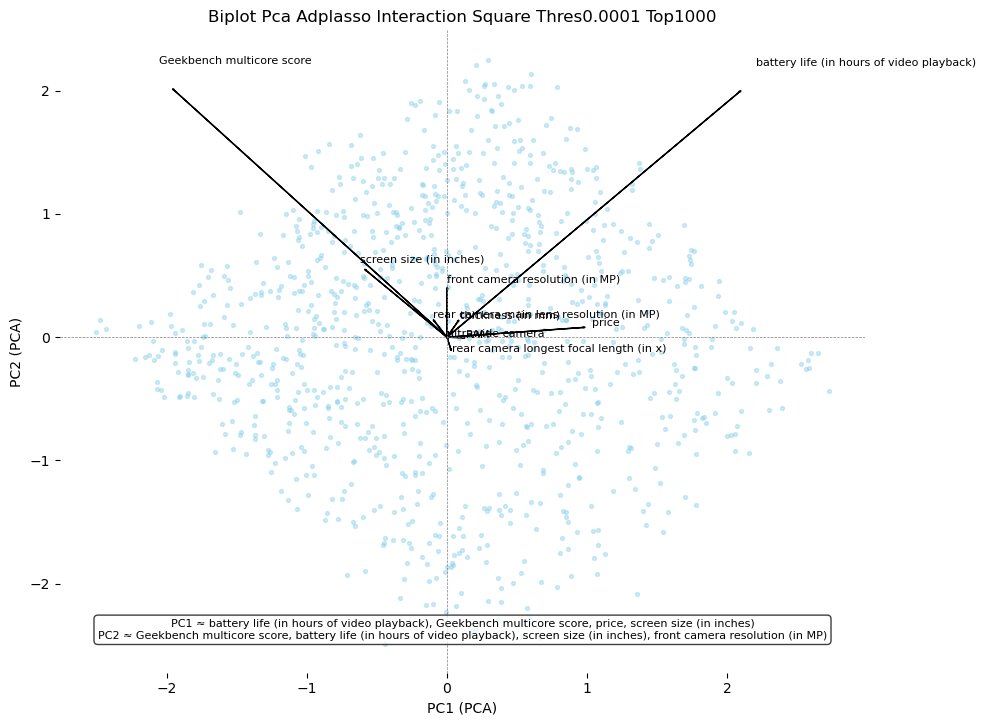

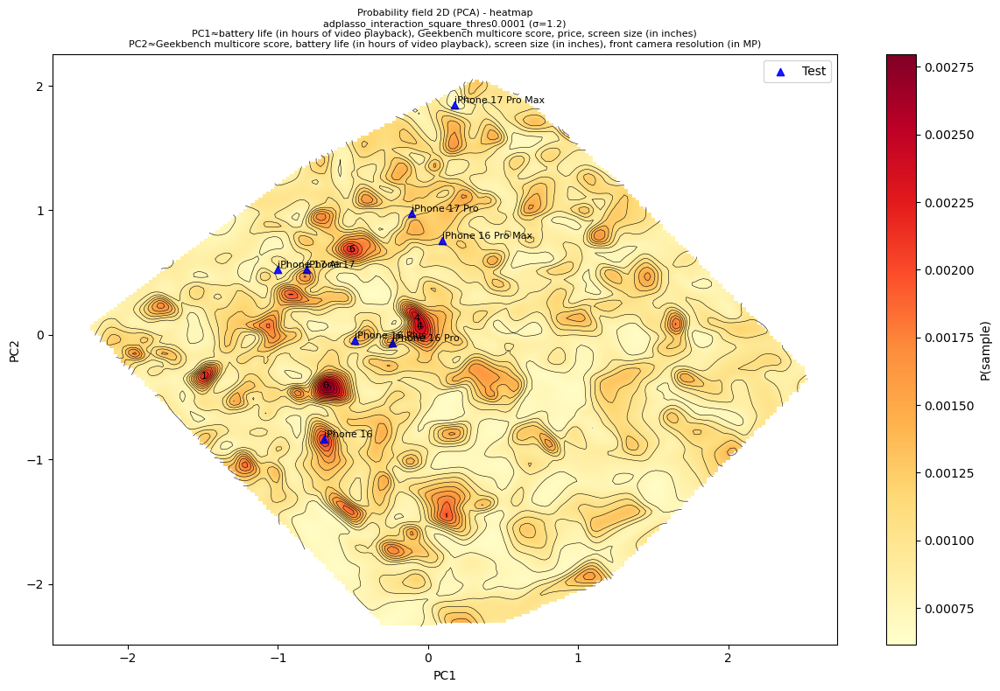

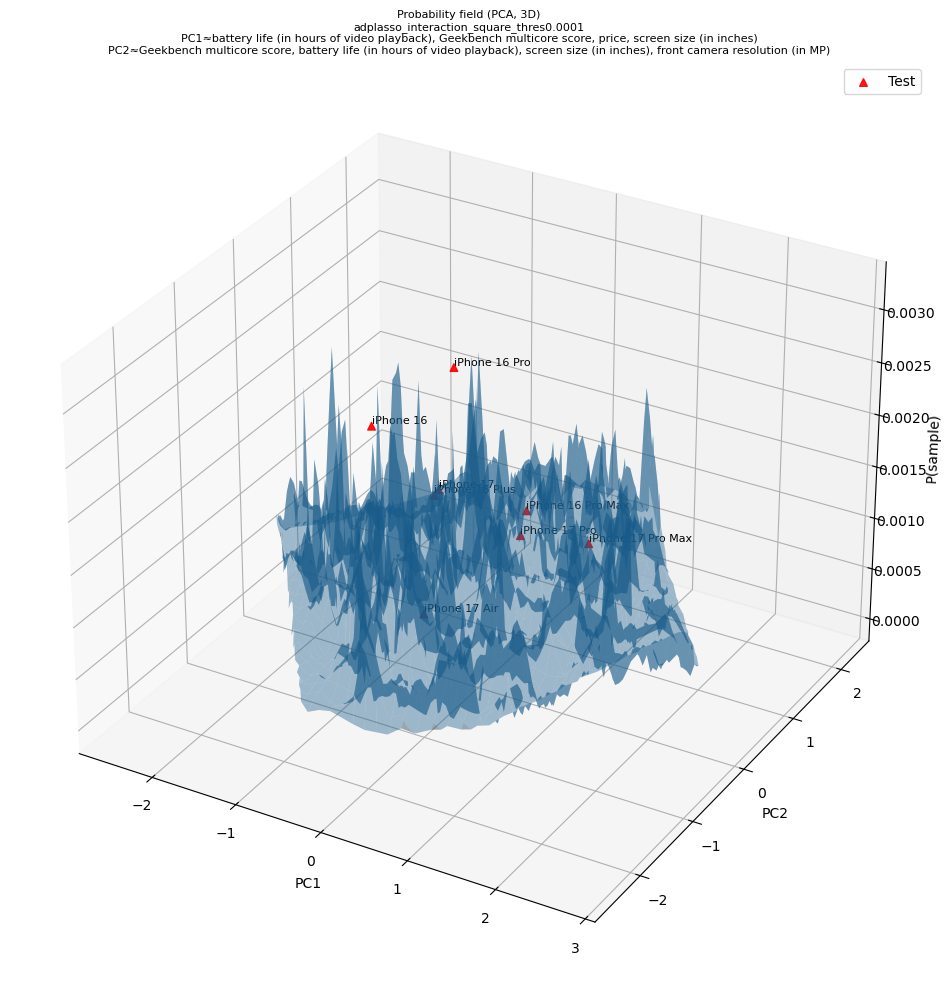

/var/folders/kd/bfykm6ds1jg2trz545lw7lnw0000gn/T/ipykernel_16055/4292791709.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_train.sort_values(by=[model_name], ascending=False, inplace=True)


Saved: ../data/PCA_loading/pca_adplasso_square_thres0.0001_top1000.csv

Top features for PC1 (by |loading|):
                                  feature       PC1       PC2
battery life (in hours of video playback)  0.887256  0.440054
                Geekbench multicore score -0.368330  0.784108
                                    price  0.268607 -0.309802
                  screen size (in inches) -0.166867  0.122462
  rear camera longest focal length (in x) -0.030318 -0.103656
                        thickness (in mm)  0.027264 -0.001474
          front camera resolution (in MP) -0.007887  0.130584
                                      RAM  0.005738 -0.009577
                         ultrawide camera -0.000798  0.000825
 rear camera main lens resolution (in MP)  0.000103  0.033380

Top features for PC2 (by |loading|):
                                  feature       PC1       PC2
                Geekbench multicore score -0.368330  0.784108
battery life (in hours of video playback)  0.88

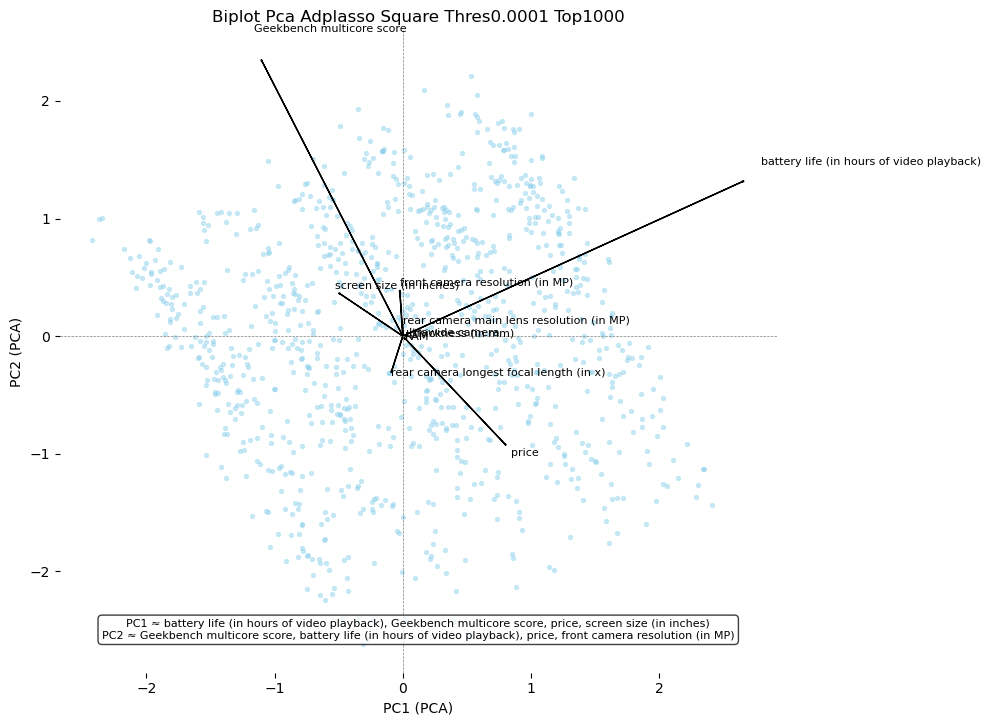

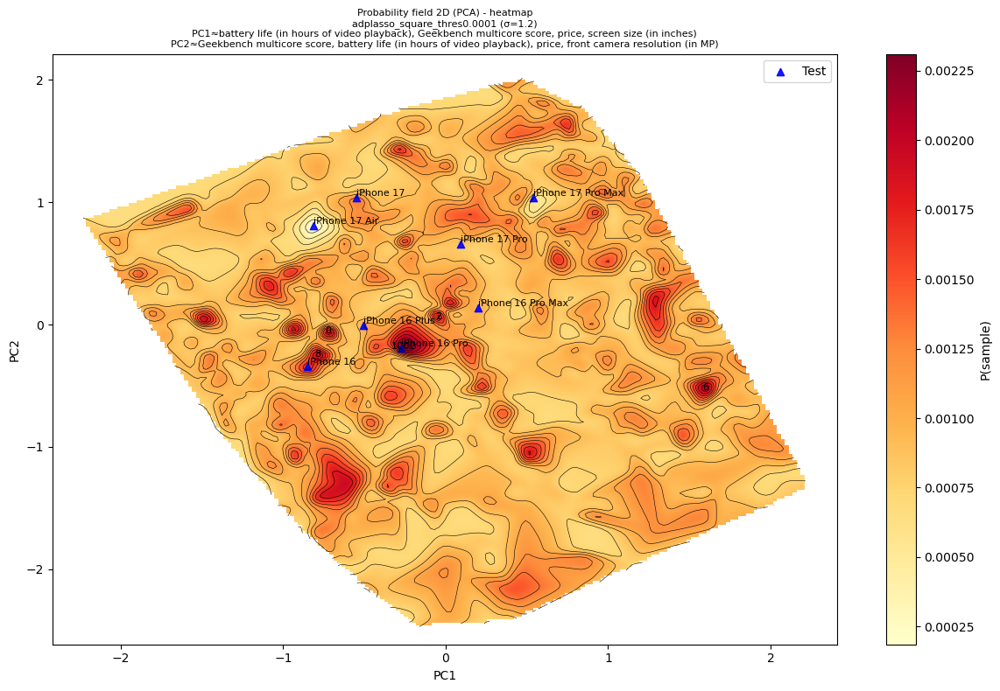

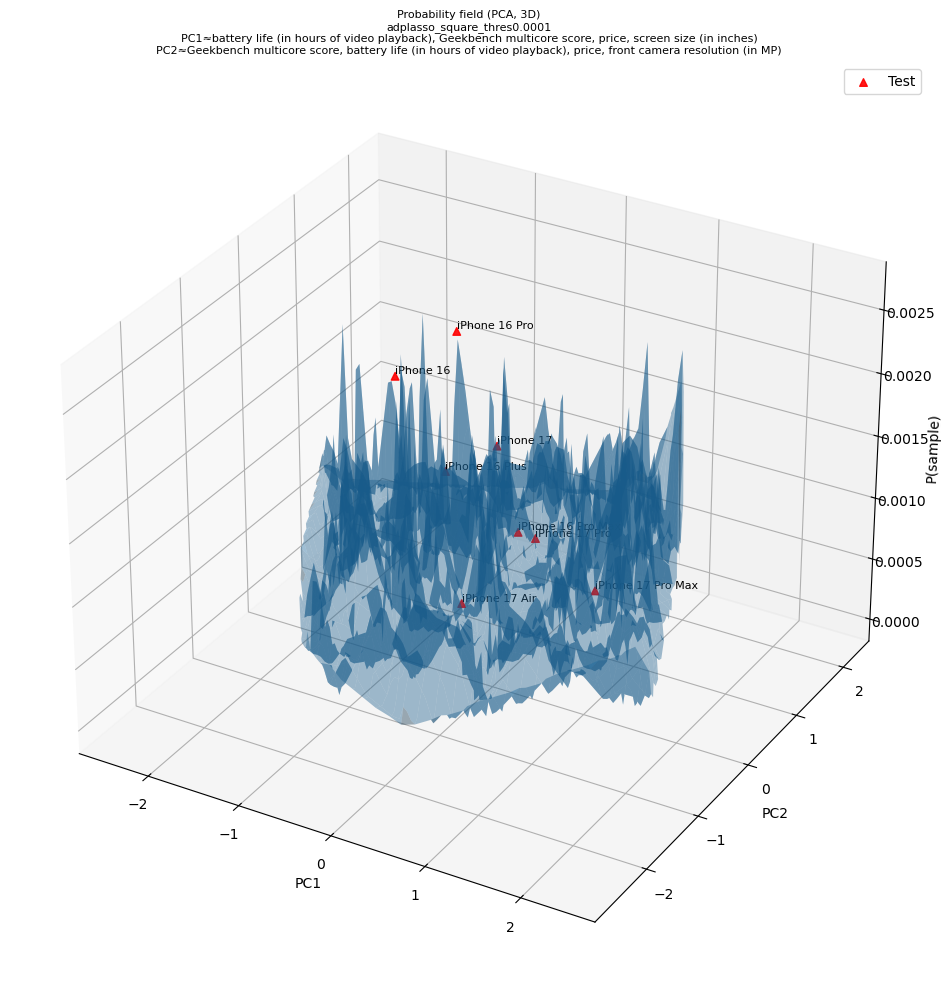

/var/folders/kd/bfykm6ds1jg2trz545lw7lnw0000gn/T/ipykernel_16055/4292791709.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_train.sort_values(by=[model_name], ascending=False, inplace=True)


Saved: ../data/PCA_loading/pca_adplasso_interaction_square_thres0.001_top1000.csv

Top features for PC1 (by |loading|):
                                  feature       PC1       PC2
battery life (in hours of video playback)  0.700111  0.667225
                Geekbench multicore score -0.653501  0.672158
                                    price  0.329220  0.026854
                  screen size (in inches) -0.196255  0.184151
                                      RAM  0.043223 -0.001482
 rear camera main lens resolution (in MP) -0.032760  0.047603
                        thickness (in mm)  0.028486  0.046711
  rear camera longest focal length (in x)  0.010319 -0.036301
                         ultrawide camera -0.000961  0.000537
          front camera resolution (in MP)  0.000686  0.134713

Top features for PC2 (by |loading|):
                                  feature       PC1       PC2
                Geekbench multicore score -0.653501  0.672158
battery life (in hours of video play

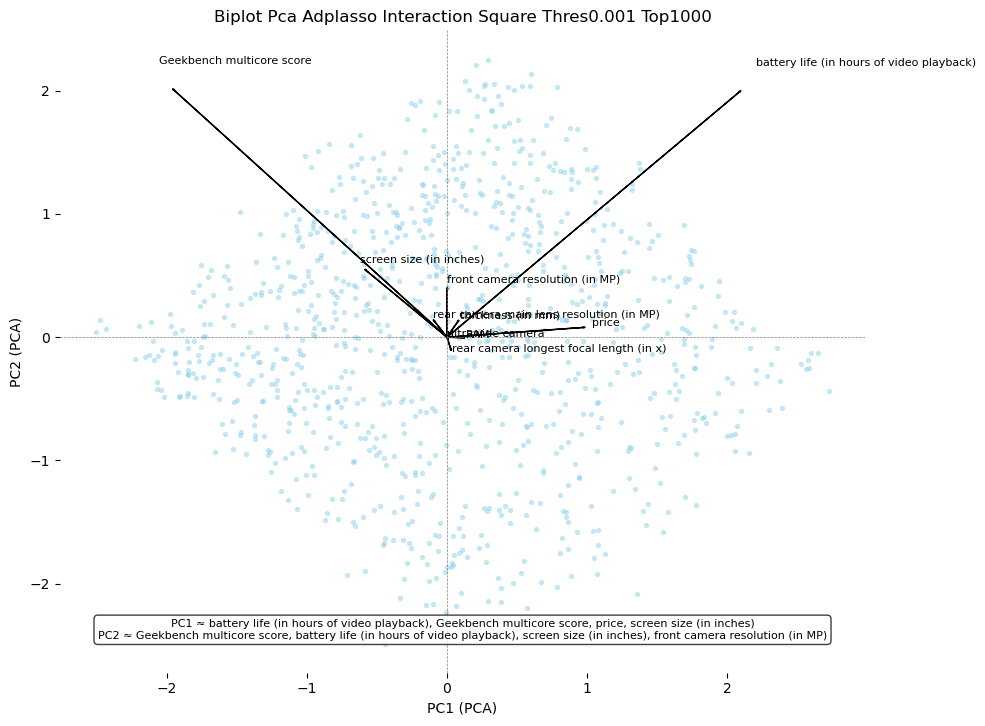

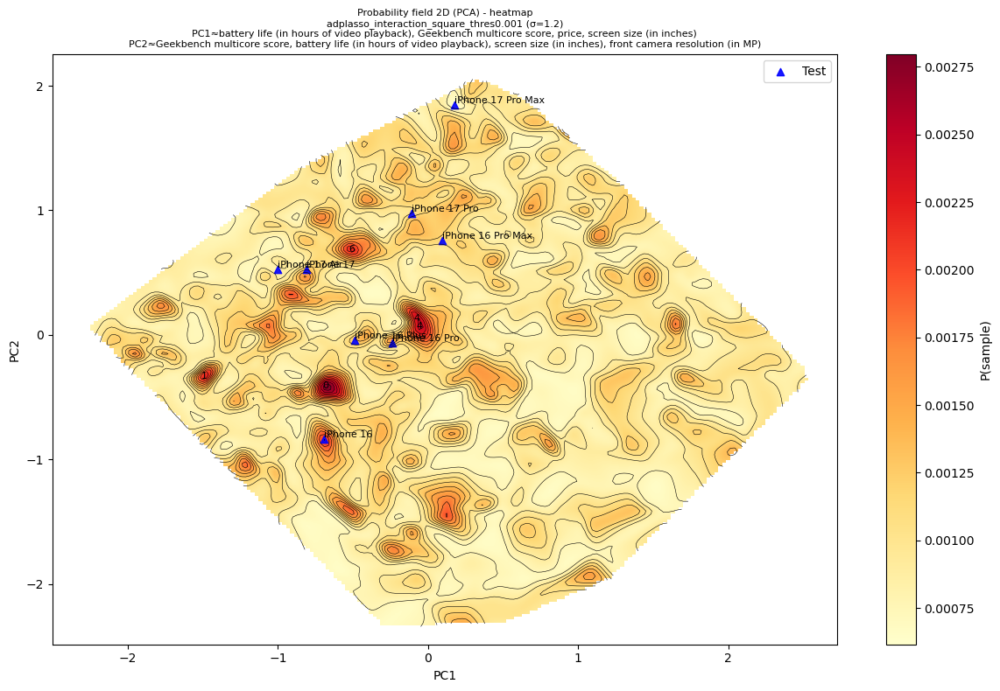

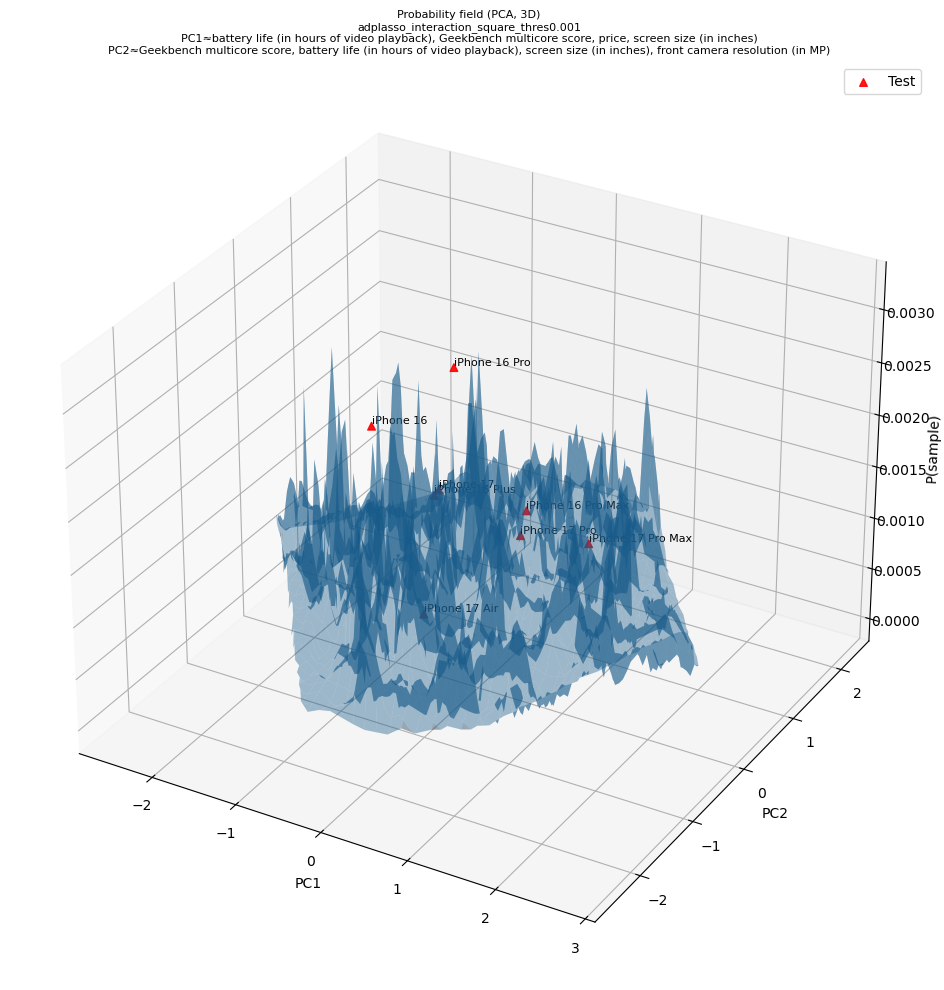

/var/folders/kd/bfykm6ds1jg2trz545lw7lnw0000gn/T/ipykernel_16055/4292791709.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_train.sort_values(by=[model_name], ascending=False, inplace=True)


Saved: ../data/PCA_loading/pca_XGBoost_top1000.csv

Top features for PC1 (by |loading|):
                                  feature       PC1       PC2
                Geekbench multicore score  0.725491  0.035463
          front camera resolution (in MP)  0.586637  0.236087
                        thickness (in mm)  0.269100  0.034656
  rear camera longest focal length (in x) -0.265157  0.024122
battery life (in hours of video playback) -0.221028  0.851624
                                    price  0.064369  0.440372
                  screen size (in inches)  0.037766 -0.113443
                                      RAM -0.036055  0.082604
                         ultrawide camera  0.000604 -0.000497
 rear camera main lens resolution (in MP)  0.000156 -0.039979

Top features for PC2 (by |loading|):
                                  feature       PC1       PC2
battery life (in hours of video playback) -0.221028  0.851624
                                    price  0.064369  0.440372
     

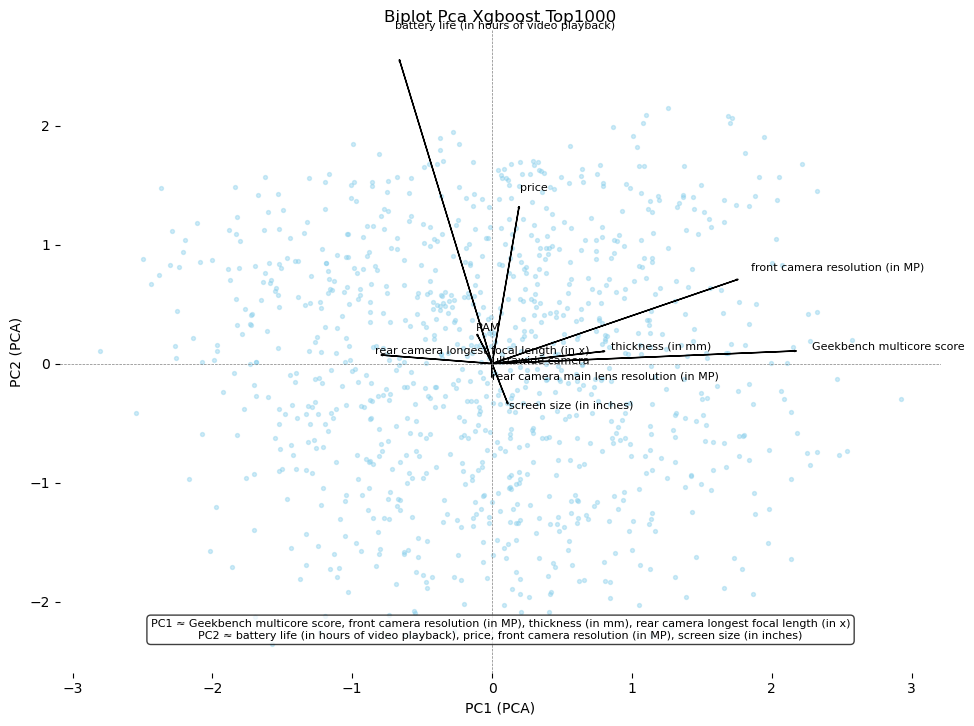

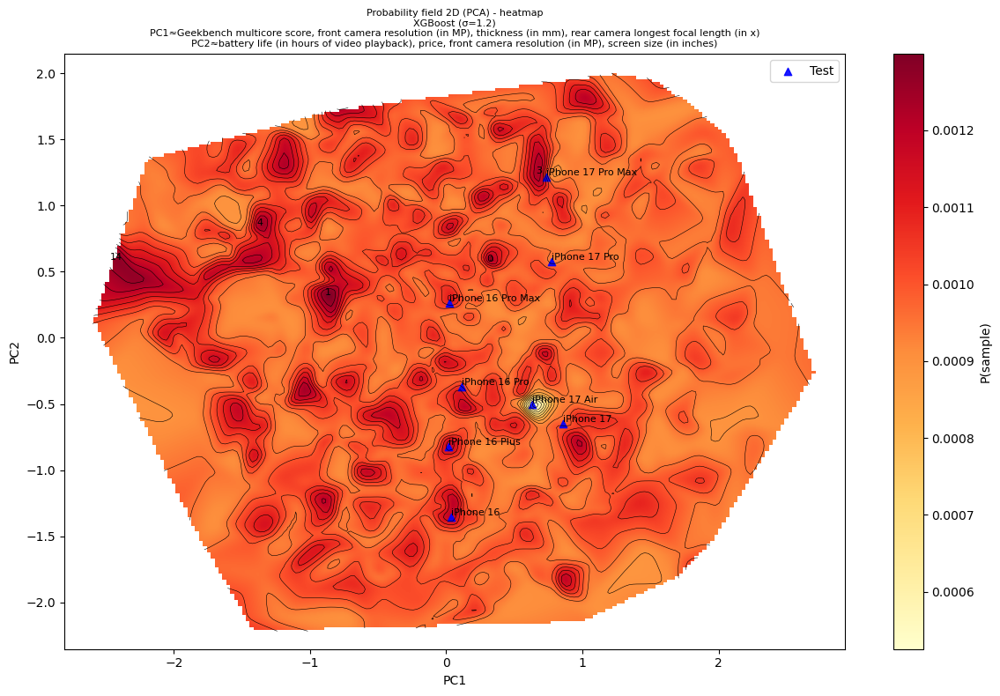

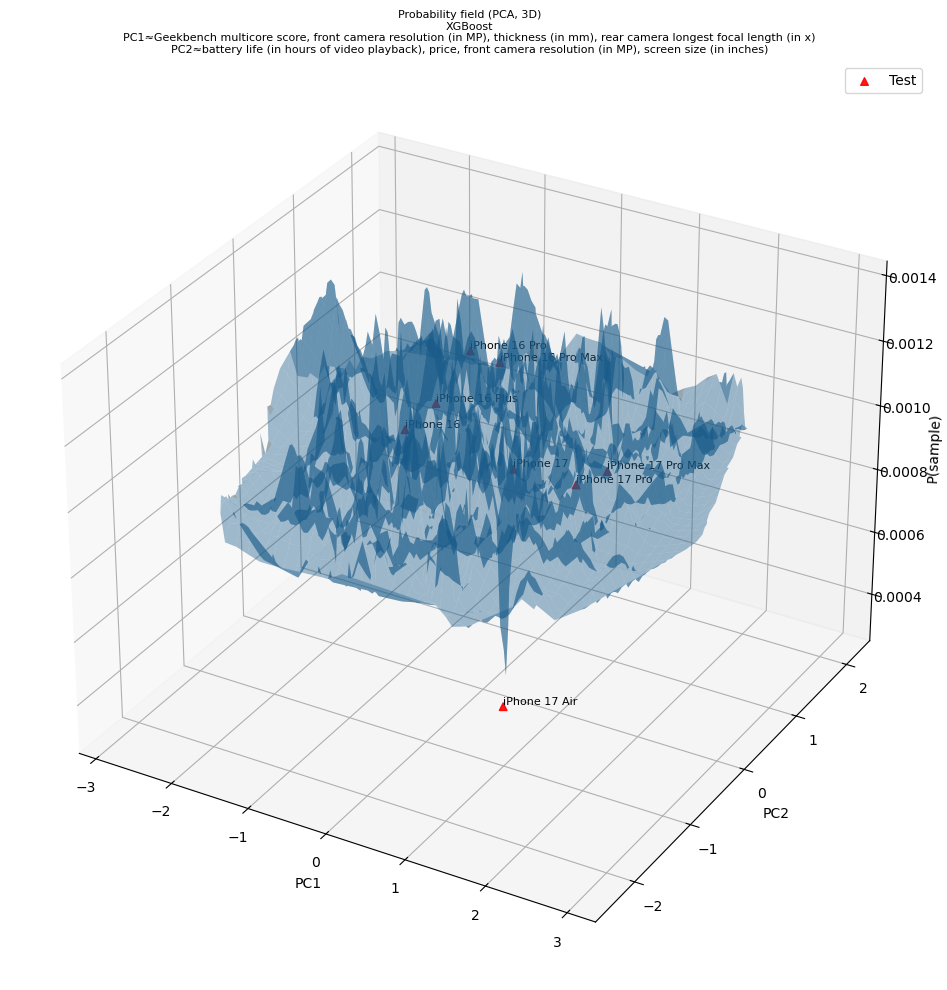

/var/folders/kd/bfykm6ds1jg2trz545lw7lnw0000gn/T/ipykernel_16055/4292791709.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_train.sort_values(by=[model_name], ascending=False, inplace=True)


Saved: ../data/PCA_loading/pca_LogitSquare_top1000.csv

Top features for PC1 (by |loading|):
                                  feature       PC1      PC2
battery life (in hours of video playback)  0.776421 0.550934
                Geekbench multicore score -0.588775 0.744114
                                    price  0.311048 0.166429
                  screen size (in inches) -0.160974 0.256024
                                      RAM  0.041170 0.011009
 rear camera main lens resolution (in MP) -0.018838 0.028233
                        thickness (in mm)  0.018780 0.021282
  rear camera longest focal length (in x)  0.009239 0.027755
          front camera resolution (in MP) -0.005670 0.136284
                         ultrawide camera -0.000882 0.000667

Top features for PC2 (by |loading|):
                                  feature       PC1      PC2
                Geekbench multicore score -0.588775 0.744114
battery life (in hours of video playback)  0.776421 0.550934
               

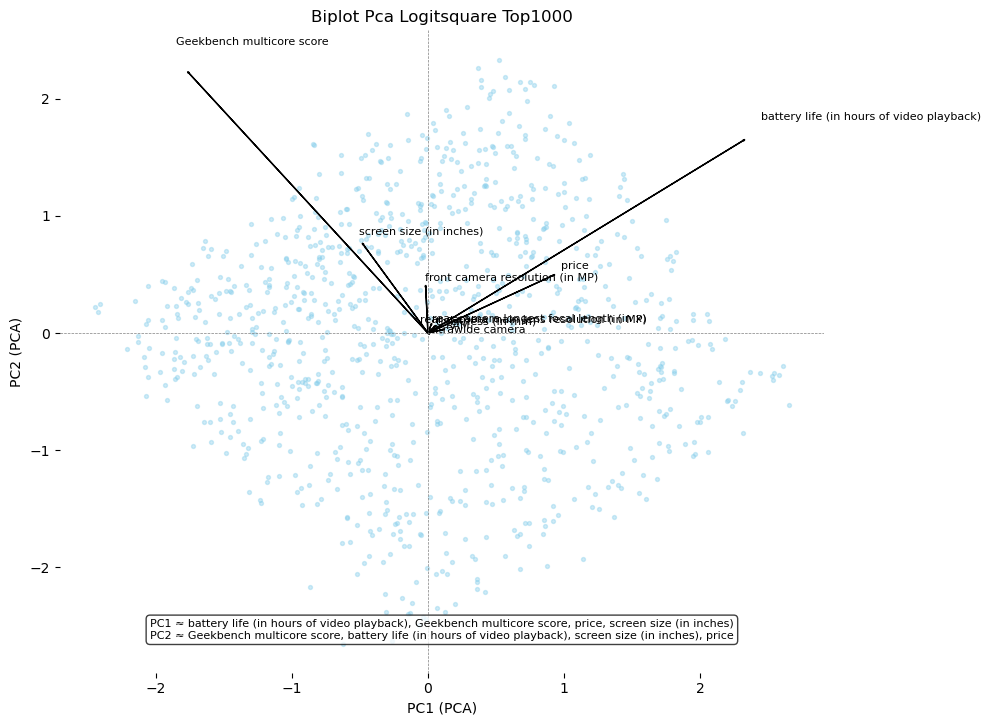

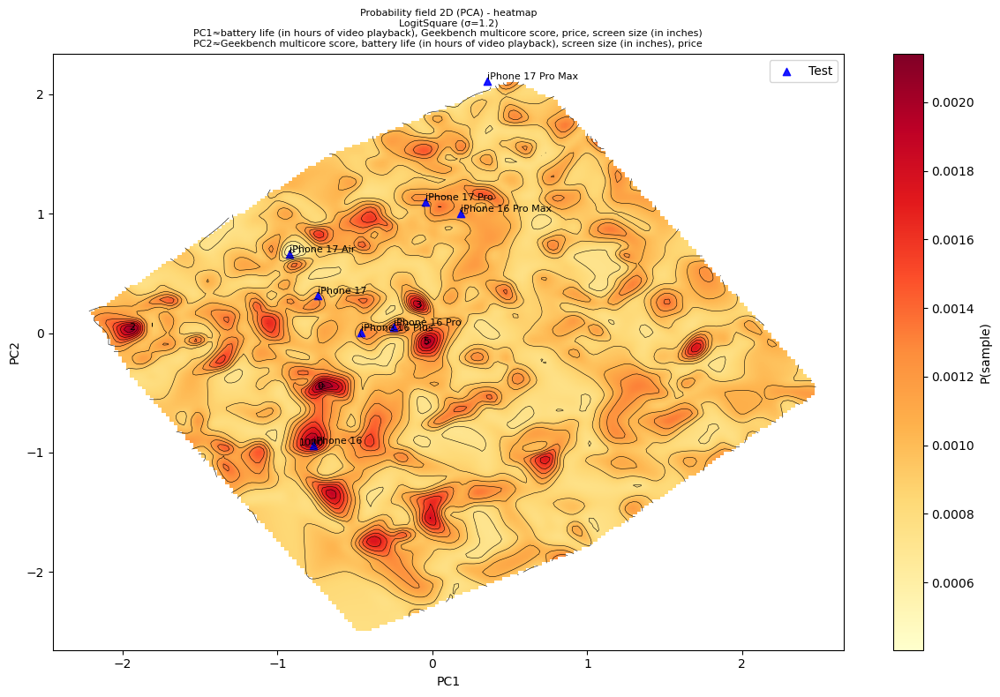

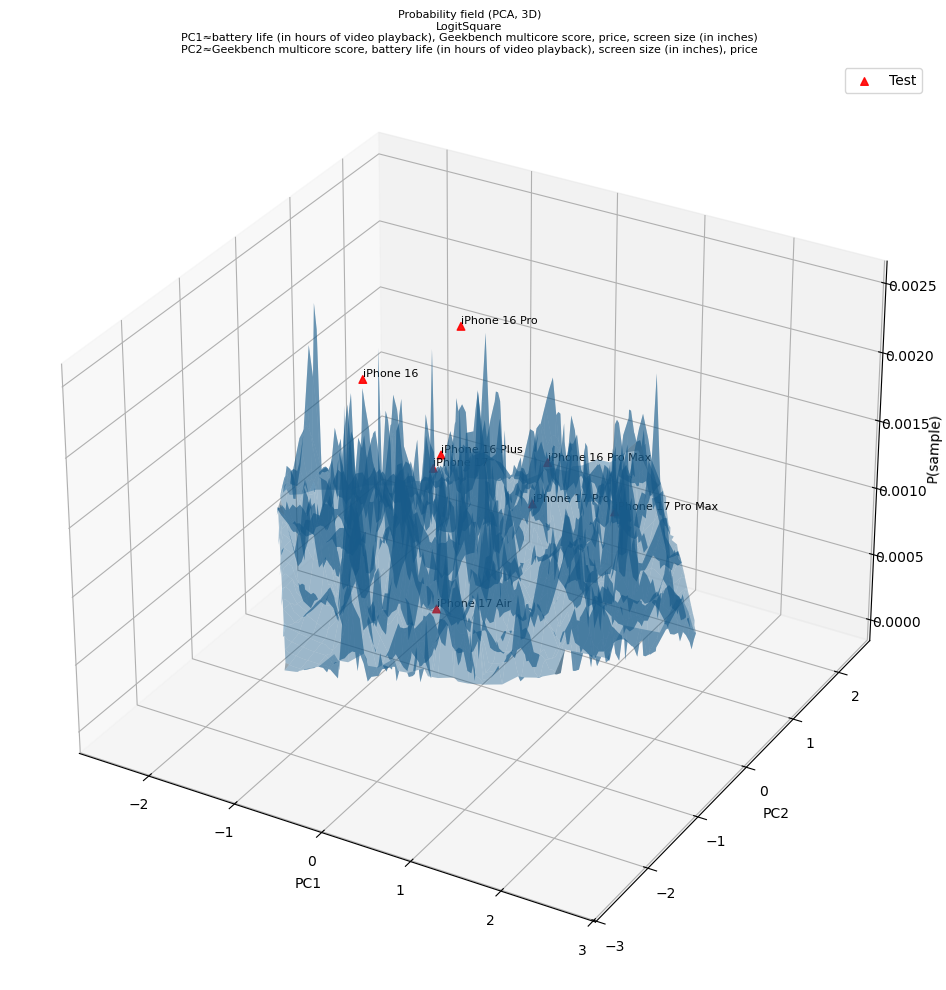

In [6]:
for model_name in score_models:
    df_train = scored_df.iloc[:20000,:]
    df_train.sort_values(by=[model_name], ascending=False, inplace=True)
    df_train = df_train.iloc[:1000,:]
    df_full = pd.concat([df_train, real_df], axis=0).reset_index(drop=True)
    scores_train = df_train[model_name].values
    scored_test = real_df[model_name].values
    X_train = preprocess_test(df_train.iloc[:,:10])
    X_test = preprocess_test(real_df.iloc[:,:10])
    scores = np.concatenate([scores_train, scored_test], axis=0)
    pca_res = pca_reduce(
        X_train=X_train,
        X_test=X_test,
        n_components=2,
        feature_names=feature_names,
        save_loadings_csv_path=f"../data/PCA_loading/pca_{model_name}_top1000.csv",
        random_state=2025
    )
    visualize_feature_contributions_pca(
        X_train=X_train,
        feature_names=feature_names,
        save_path=f"../plot/biplot_PCA_{model_name}_top1000.png",
        pca_result=pca_res
    )
    represent_idx = visualize_probability_distribution(
        X_full=torch.cat([X_train, X_test], dim=0),
        scores=scores,
        num_test=8,
        plot_kind="heatmap",
        smooth_sigma=1.2,
        fig_name=f"PCA_heatmap_{model_name}_top1000.png",
        score_model=model_name,
        pca_result=pca_res,
        represent_method="peaks",
        test_idx=real_df['profile_id'].values.tolist(),
    )
    represent_idx = represent_idx.representative_indices
    df_full.iloc[represent_idx,:].to_csv(f"../data/analysis_representative_PCA/PCA_heatmap_{model_name}_top1000.csv", index=True)
    _ = visualize_probability_distribution(
        X_full=torch.cat([X_train, X_test], dim=0),
        scores=scores,
        num_test=8,
        plot_kind="3d",
        fig_name=f"PCA_3d_{model_name}_top1000.png",
        score_model=model_name,
        pca_result=pca_res,
        test_idx=real_df['profile_id'].values.tolist(),
    )